Index of dom freq: (39, 49, 10)
Dominant Frequency: 2.5269859276642848


/Users/nicknugraha/AMATH482/.conda/lib/python3.11/site-packages/matplotlib/cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/Users/nicknugraha/AMATH482/.conda/lib/python3.11/site-packages/matplotlib/collections.py:200: ComplexWarning: Casting complex values to real discards the imaginary part
  offsets = np.asanyarray(offsets, float)


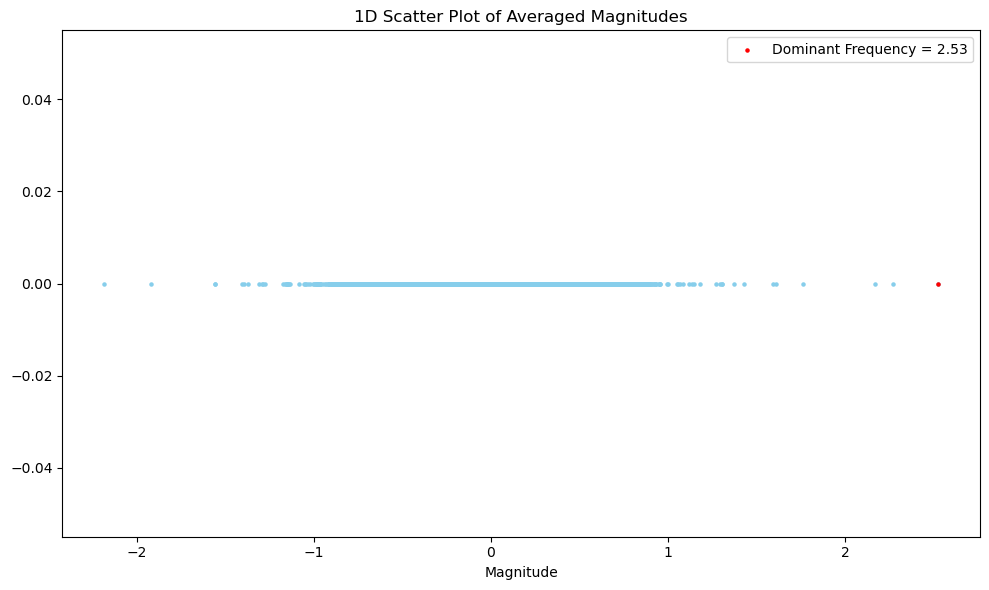

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objs as go
from IPython.display import clear_output

data_path = '/Users/nicknugraha/AMATH482/HW1/subdata.npy'

d = np.load(data_path)

N_grid = 64
avg_magnitude = None

for j in range(d.shape[1]):
    signal_reshaped = np.reshape(d[:,j], (N_grid, N_grid, N_grid))

    fhat = np.fft.fftn(signal_reshaped, axes=None)
    fhat_shifted = (1/N_grid) * np.fft.fftshift(fhat)

    if avg_magnitude is None:
        avg_magnitude = fhat_shifted
    else:
        avg_magnitude += fhat_shifted

avg_magnitude /= d.shape[1]

dom_freq_index = np.unravel_index(np.argmax(avg_magnitude), avg_magnitude.shape)

i = dom_freq_index[0]
j = dom_freq_index[1]
k = dom_freq_index[2]

print(f"Index of dom freq: ({i}, {j}, {k})")
print("Dominant Frequency:", avg_magnitude[i,j,k].real)

plt.figure(figsize=(10,6))
plt.scatter(avg_magnitude.flatten(), np.zeros((64*64*64,)), color="skyblue", s=5)
plt.scatter(avg_magnitude[i,j,k], 0, color="red", s=5, label=f"Dominant Frequency = {round(avg_magnitude[i,j,k].real, 2)}")
plt.legend()
plt.title("1D Scatter Plot of Averaged Magnitudes")
plt.xlabel("Magnitude")

plt.tight_layout()
plt.show()


In [ ]:
Lh = 10  
N_grid = 64  
xx = np.linspace(-Lh, Lh, N_grid + 1) 
x = xx[0:N_grid]
y = x  
z = x
K_grid = (2 * np.pi / (2 * Lh)) * np.linspace(-N_grid / 2, N_grid / 2 - 1, N_grid)  

xv, yv, zv = np.meshgrid(x, y, z, indexing="ij")
kx, ky, kz = np.meshgrid(K_grid, K_grid, K_grid, indexing="ij")

Gaussian_filter = np.exp(-0.001 * (kx**2 + ky**2 + kz**2))

filtered_fhat = avg_magnitude * Gaussian_filter

shifted_fhat = np.fft.ifftshift(filtered_fhat)

filtered_signal = np.fft.ifftn(shifted_fhat)

filtered_normalized = np.abs(filtered_signal) / np.abs(filtered_signal).max()

fig_data = go.Isosurface(
    x=xv.flatten(), y=yv.flatten(), z=zv.flatten(),
    value=filtered_normalized.flatten(), isomin=0.65, isomax=0.66
)

clear_output(wait=True) 
fig = go.Figure(data=fig_data)

fig.show()



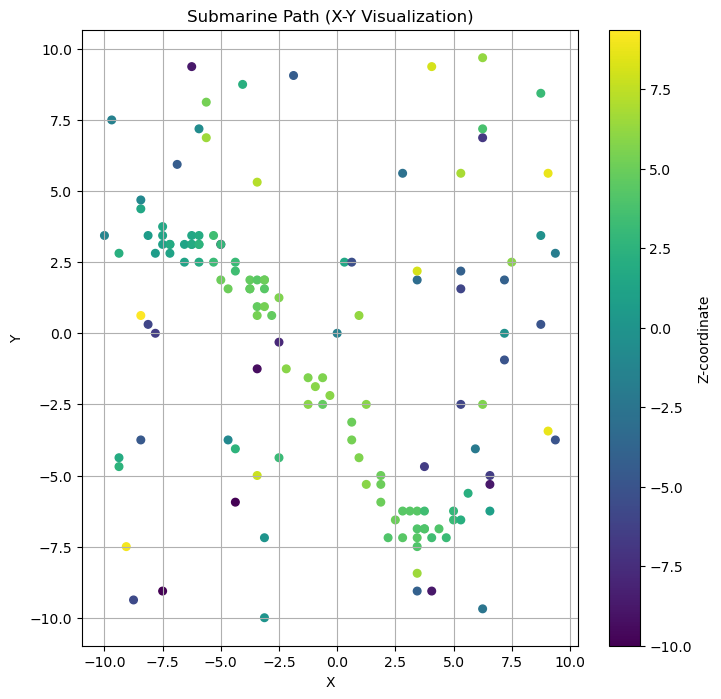

In [43]:
threshold = 0.72
indices = np.where(filtered_normalized >= threshold)

x_path = xv[indices]
y_path = yv[indices]
z_path = zv[indices]

plt.figure(figsize=(8, 8))
scatter = plt.scatter(x_path, y_path, c=z_path, cmap='viridis', s=30)
plt.colorbar(scatter, label='Z-coordinate')
plt.title("Submarine Path (X-Y Visualization)")
plt.xlabel("X")
plt.ylabel("Y")
plt.grid(True)
plt.show()

